##### Tiago Lyrio

RA: 046799

In [1]:
import os

import numpy as np
from numpy.fft import fft2, ifft2, fftshift, ifftshift

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import axes3d
from seaborn import color_palette

import skimage
from skimage.filters import window
from skimage import util

In [2]:
from mo443_lib import draw_square
from mo443_lib import read_imgs
from mo443_lib import show_hist
from mo443_lib import compare_imgs
from mo443_lib import plot_fft_histogram

## Importando o banco de imagens

### Imagens em tons de cinza.

In [3]:
img_path = 'https://www.ic.unicamp.br/~helio/imagens_pgm/'
#img_path = 'imagens_pgm/'

images,img_names = read_imgs(loc='url',img_path=img_path)

total de imagens: 7
imagens: ['baboon.pgm', 'fiducial.pgm', 'monarch.pgm', 'peppers.pgm', 'retina.pgm', 'sonnet.pgm', 'wedge.pgm']

Detalhes:
baboon.pgm: 	max = 248 	min = 0 	shape = (512, 512) 	type = uint8
fiducial.pgm: 	max = 255 	min = 2 	shape = (480, 640) 	type = uint8
monarch.pgm: 	max = 244 	min = 17 	shape = (512, 768) 	type = uint8
peppers.pgm: 	max = 255 	min = 0 	shape = (594, 623) 	type = uint8
retina.pgm: 	max = 255 	min = 0 	shape = (256, 256) 	type = uint8
sonnet.pgm: 	max = 251 	min = 27 	shape = (510, 384) 	type = uint8
wedge.pgm: 	max = 246 	min = 53 	shape = (384, 507) 	type = uint8


##### Atribuindo constantes aos nomes de cada imagem para facilitar o código:

In [5]:
baboon   = 0
fiducial = 1
monarch  = 2
peppers  = 3
retina   = 4
sonnet   = 5
wedge    = 6

### Histograma das imagens

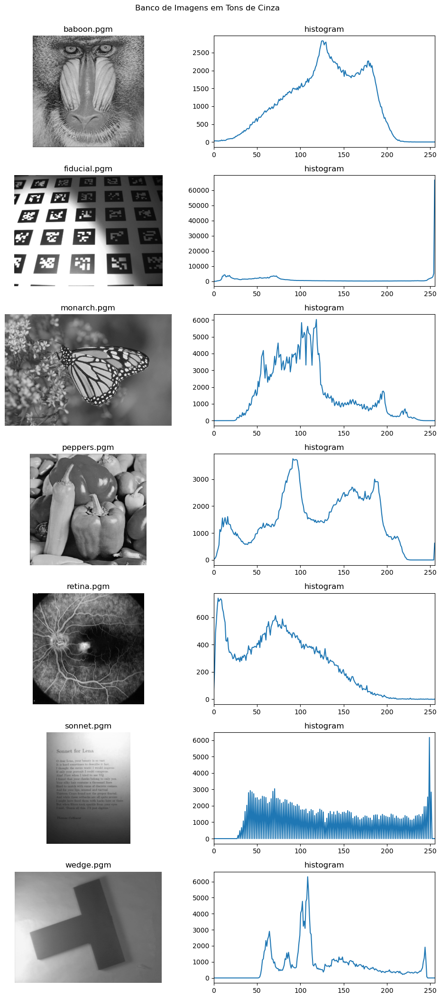

In [6]:
title = 'Banco de Imagens em Tons de Cinza'
show_hist(images,img_names, title = title);

---

# Filtragem no Domínio de Frequência

A teoria de Fourier diz que qualquer sinal, ou imagens, pode ser expresso como uma soma de uma série de sinusóides (senos e cossenos).
No caso de imagens visuais normais, essas são variações sinusoidais na intensidade luminosa da imagem.

A transformada discreta de Fourier se obtém através da equação: 

$$F(u)=\frac{1}{N}\sum_{x = 0}^{N-1} f(x)exp[\frac{-j2\pi ux}{N}]$$

, onde $j=\sqrt{-1}$ e lembrando que $e^{j\phi}=\cos(\phi) + j \sin(\phi)$

As características mais relevantes da transformada de Fourier são:
- Não muda (aumenta ou diminui) a informação contida no sinal  
  *Ao aplicar a transformada de Fourier em uma imagem e depois aplicar a transformada inversa, a imagem é recuperada sem perdas)*
- Transformada de Fourier 2D é separável.  
  *Conhecida como FFT Fast Fourier Transform (diminui a coplexidade de $N^2$ para $N.log(N)$*
- Filtragens no espectro da frequência são realizadas através simples multiplicações.

Como outras funções complexas pode ser escrita na forma também na forma exponencial:  
$F(u)=|F(u)|. e^{j\phi (u)}$  
Ou seja, possui uma magnitude e uma fase

A filtragem das imagens no domínio de frequência possibilita a alteração de seus valores originais em novas informações, de forma a atenuar ruído nas imagens, suavizar os dados, aumentar o contraste, realçar detalhes (bordas) das imagens, entre outras operações. A transformada rápida de Fourier (do inglês, Fast Fourier Transform - FFT) deve ser aplicada em imagens digitais, convertendo-as para o domínio de frequência.

### Window Functions

As window functions são máscaras que serão usadas como filtros no domínio da frequência. Todas tem um raio e o que varia é a forma que a intensidade do centro (1) transita para a intensidade da borda (0). Podendo ser abrupta ou gradual, das mais diversas formas.

No link abaixo encontra-se a lista completa delas:  
https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.windows.get_window.html

Vamos vizualizar algumas dessas máscaras:

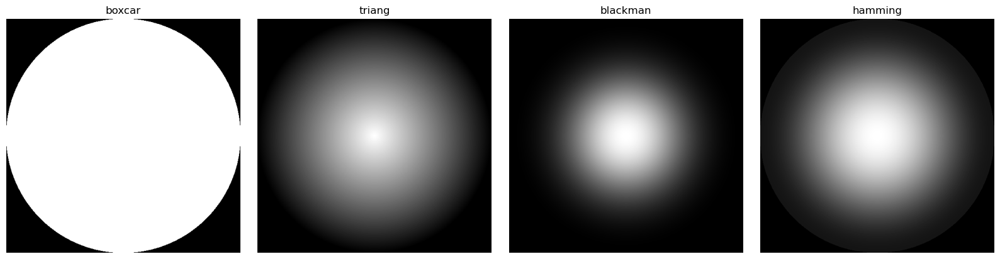

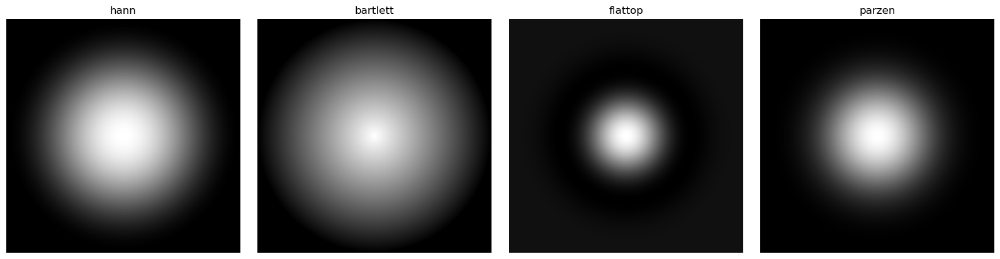

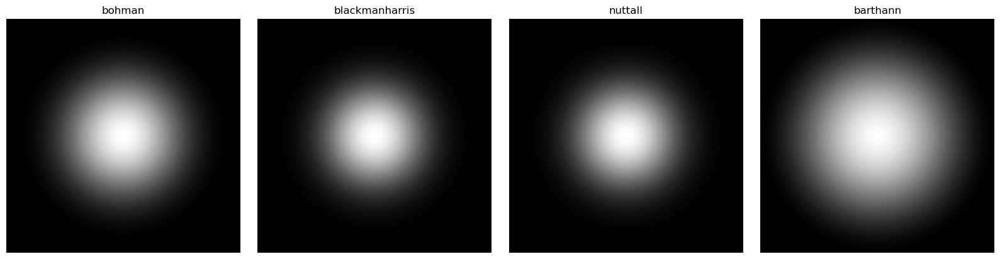

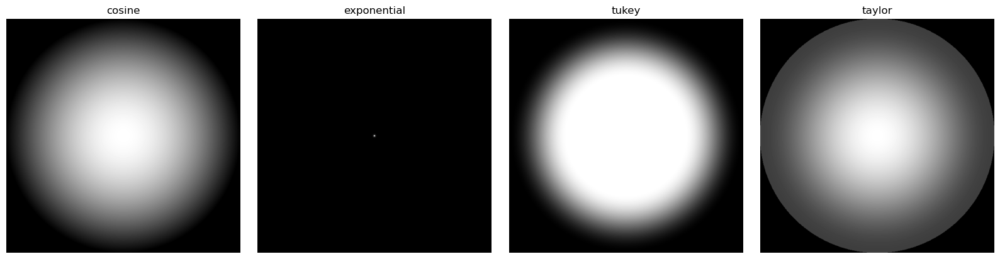

In [18]:
masks_names = ['boxcar','triang','blackman','hamming','hann','bartlett','flattop','parzen', 'bohman',
               'blackmanharris','nuttall','barthann','cosine','exponential','tukey','taylor']

shape = (512, 512)

masks_to_compare = [window(mask_name, shape) for mask_name in masks_names]

n=4
for i in range(int(len(masks_names)/n)):
    index = np.s_[i*n:i*n+n]
    compare_imgs(masks_to_compare[index],
                 masks_names[index],
                 title='',
                 black_pixels_ratio=False);

Essas máscaras podem ser utilizadas individualmente ou de forma combinada (ou até mesmo invertida), para atingir o resultado desejado. Sempre tendo em mente que, as baixas frequências (responsáveis pelo preenchimento da imagem) estão no centro da máscara e, quanto mais longe do centro, maior a frequência (as mais altas são responsáveis pelos contornos e detalhes).  
Ao aplicar uma máscara no domínio da frequência, através de uma multiplicação, quanto mais branca é a região da máscara, uma maior parte da sua respectiva frequência será preservada.

### Passo a passo para a aplicação do filtro

Vamos utilizar a imagem do babuíno em preto e branco para estudar a filtragem no domínio da frequência

Para aplicar o filtro no domínio da frequência precisamos primeiro aplicar a transformada de Fourier à imagem. Após transformada, a imagem terá as baixas frequências proximas à posição (0,0) da imagem. Para facilitar o manuseio, vamos deslocar as frequências baixas para  centro da imagem. Feito isso, basta multiplicar a transformada centralizada pelo filtro e depois reverter o processo (descentralizar e aplicar a transformada de Fourier inversa).

In [19]:
def fft_apply_filter(img,mask,return_steps=False):
    '''
    Aplica um filtro no domínio da frequência utilizando FFT.
    Features:
        img          -> imagem a ser comprimida
        mask         -> filtro a ser aplicado
        return_steps -> False: retorna apenas a imagem filtrada
                        True : retorna todos os passos do processo (prontos para plotar)
    '''
    #calcula a transformada de fourier
    original_fft = fft2(img)
    #centraliza a transformada
    center_fft = fftshift(original_fft)
    #aplica o filtro através de uma multiplicação
    filter_center_fft = center_fft * mask
    #descentraliza a transformada já filtrada
    filter_fft = ifftshift(filter_center_fft)
    #calcula a transformada inversa
    filtered_img = ifft2(filter_fft)

    if return_steps:
        fft_steps = [img,mask,np.abs(filtered_img),np.log(1+np.abs(original_fft)),np.log(1+np.abs(center_fft)),
                     np.log(1+np.abs(filter_center_fft)),np.log(1+np.abs(filter_fft))]
        labels = ['Original','Filtro','Imagem Filtrada','FFT da imagem original',
          'FFT centralizada','FFT centralizada filtrada','FFT da imagem filtrada']
        return fft_steps,labels
    else:
        return np.abs(filtered_img)

A seguir, visualizaremos o passo a passo desse processo para cada tipo de filtro.

### Função para gerar cada tipo de filtro

In [20]:
def low_pass_filter(mask_size, center_size, mask_type = 'boxcar'):
    '''
    Recebe uma imagem, o tamanho e o tipo da window function e retorna uma máscara de um filtro passa baixa
    Features:
        mask_size   -> tamanho do filtro
        center_size -> tamanho do centro do filtro
        mask_type   -> tipo da máscara. São aceitos os valores abaixo:
                       ['boxcar','triang','blackman','hamming','hann','bartlett','flattop','parzen', 'bohman',
                       'blackmanharris','nuttall','barthann','cosine','exponential','tukey','taylor']
                    
    Return:
        mask        -> filtro a ser utilizado no domínio da frequência
    '''

    #aqui é feito um pequeno ajuste em alguns casos
    #esse ajuste e feito no tamanho da máscara para garantir que ela ficará centralizada
    #portanto o tamanho da máscara utilizada pode diferir em uma unidade em cada uma das dimensões
    if int(mask_size[0] - center_size[0])%2 == 1:
        center_size[0] += 1
    if int(mask_size[1] - center_size[1])%2 == 1:
        center_size[1] += 1

    #verifica se o tamanho do filtro é menor que o da imagem
    if np.any(np.array(center_size)>img.shape):
        raise ValueError(f'low_pass_filter: o tamanho do filtro deve ser menor que a imagem')
    
    #chama a window function selecionada e cria o centro do filtro
    mask = window(mask_type, center_size)
    
    #completa o resto do filtro com zeros
    v_pad_size = int((mask_size[0] - center_size[0])/2)
    h_pad_size = int((mask_size[1] - center_size[1])/2)
    mask = np.pad(mask,
                  pad_width=[(v_pad_size,v_pad_size),(h_pad_size,h_pad_size)],
                  mode='constant',
                  constant_values= 0
                 )
    
    #retorna o filtro gerado
    return mask

def high_pass_filter(mask_size, center_size, mask_type = 'boxcar'):
    '''
    Recebe uma imagem, o tamanho e o tipo da window function e retorna uma máscara de um filtro passa alta
    Para gerar o filtro passa alta é utilizado o complementar do filtro passa baixa
    Features:
        mask_size   -> tamanho do filtro
        center_size -> tamanho do centro do filtro
        mask_type   -> tipo da máscara. São aceitos os valores abaixo:
                       ['boxcar','triang','blackman','hamming','hann','bartlett','flattop','parzen', 'bohman',
                       'blackmanharris','nuttall','barthann','cosine','exponential','tukey','taylor']
                    
    Return:
        mask        -> filtro a ser utilizado no domínio da frequência
    '''
    return 1-low_pass_filter(mask_size, center_size, mask_type)

def band_pass_filter(mask_size, center_size, center_size_lower, mask_type = 'boxcar'):
    '''
    Recebe uma imagem, o tamanho interno, externo e o tipo da window function e retorna uma máscara de um filtro passa faixa
    Para gerar o filtro são combinados os filtros passa alta (menor diâmetro) e um passa baixa (maior diâmetro) 
    utilizando a função minimun (que seria análogo a combinar duas máscaras binárias com um and)
    Features:
        mask_size         -> tamanho do filtro
        center_size       -> tamanho do centro do filtro (diâmetro maior)
        center_size_lower -> tamanho do centro do filtro (diâmetro menor)
        mask_type         -> tipo da máscara. São aceitos os valores abaixo:
                             ['boxcar','triang','blackman','hamming','hann','bartlett','flattop','parzen', 'bohman',
                             'blackmanharris','nuttall','barthann','cosine','exponential','tukey','taylor']
                    
    Return:
        mask              -> filtro a ser utilizado no domínio da frequência
    '''
    #verifica se center_size tem os valores maior que center_size_lower
    if np.any(center_size<=center_size_lower):
        raise ValueError(f'band_pass_filter: center_size deve ser maior que center_size_lower')
    
    return np.minimum(low_pass_filter(mask_size, center_size, mask_type),high_pass_filter(mask_size, center_size_lower, mask_type))

def band_stop_filter(mask_size, center_size, center_size_lower, mask_type = 'boxcar'):
    '''
    Recebe uma imagem, o tamanho interno, externo e o tipo da window function e retorna uma máscara de um filtro rejeita faixa
    Para gerar o filtro é utilizado o complementar do filtro passa banda
    Features:
        mask_size         -> tamanho do filtro
        center_size       -> tamanho do centro do filtro (diâmetro maior)
        center_size_lower -> tamanho do centro do filtro (diâmetro menor)
        mask_type         -> tipo da máscara. São aceitos os valores abaixo:
                             ['boxcar','triang','blackman','hamming','hann','bartlett','flattop','parzen', 'bohman',
                             'blackmanharris','nuttall','barthann','cosine','exponential','tukey','taylor']
                    
    Return:
        mask              -> filtro a ser utilizado no domínio da frequência
    '''
    return 1 - band_pass_filter(mask_size, center_size, center_size_lower, mask_type)

In [21]:
def fft_filter(mask_size, filter_type, center_size, center_size_lower=None, mask_type = 'boxcar'):
    '''
    Gera um filtro para o domínio da frequência.
    Features:
    mask_size       -> tamanho do filtro
    filter_type     -> tipo do filtro que será gerado. 
                       Valores permitidos: ['low_pass', 'high_pass', 'band_pass', 'band_stop']
    center_size       -> diâmetro do filtro
    center_size_lower -> diâmetro interno do filtro.
                       * se aplica apenas a filtros do tipo 'band_pass' e 'band_stop'
    mask_type       -> tipo da window function que será usada
    '''

    mask_type_options = ['boxcar','triang','blackman','hamming','hann','bartlett',
                         'flattop','parzen', 'bohman','blackmanharris','nuttall',
                         'barthann','cosine','exponential','tukey','taylor']
    filter_type_options = ['low_pass', 'high_pass', 'band_pass', 'band_stop']
    
    if mask_type not in mask_type_options:
        raise ValueError(f"fft_filter: mask_type inválido.\nValores válidos para mask_type:\n{mask_type_options}")

    if filter_type == 'low_pass':
        return low_pass_filter(mask_size, center_size, mask_type)
    elif filter_type == 'high_pass':
        return high_pass_filter(mask_size, center_size, mask_type)
    elif filter_type == 'band_pass':
        return band_pass_filter(mask_size, center_size, center_size_lower, mask_type)
    elif filter_type == 'band_stop':
        return band_stop_filter(mask_size, center_size, center_size_lower, mask_type)
    else:
        raise ValueError(f"fft_filter: filter_type inválido.\nValores válidos para mask_type:\n{filter_type_options}")

## Passa-baixa

Tendo em mente que os detalhes da imagem se encontra nas altas frequências e o preenchimento nas baixas. Ao deixar passar apenas as frequências mais baixas, teremos um efeito de borramento da imagem.

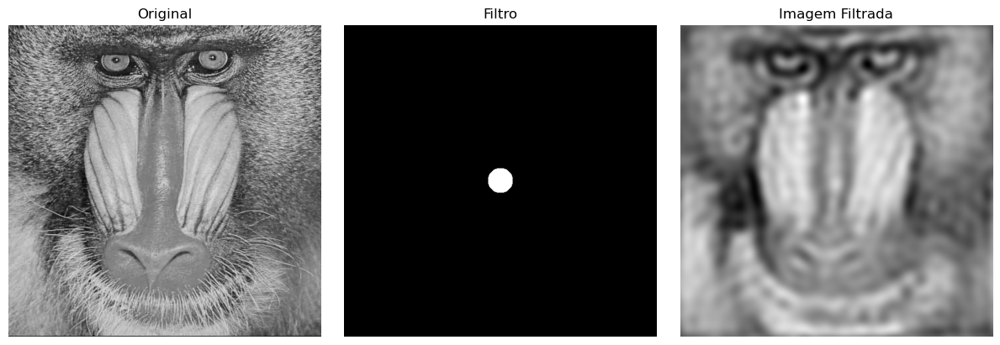

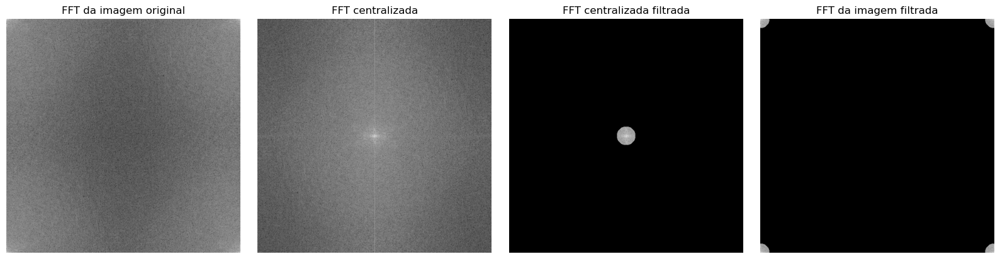

In [22]:
img  = images[baboon]
center_size = [40,40]
mask = fft_filter(img.shape,'low_pass', center_size, mask_type = 'boxcar')

fft_steps, labels = fft_apply_filter(img,mask,return_steps=True)


compare_imgs(fft_steps[0:3],
             labels[0:3],
             title='',
             black_pixels_ratio=False);
compare_imgs(fft_steps[3:],
             labels[3:],
             title='',
             black_pixels_ratio=False);

### Testando diferentes tamanhos

Abaixo podemos observar que, conforme o tamanho do filtro diminui, temos menos detalhes na imagem resultante, intensificando assim o efeito de borramento.

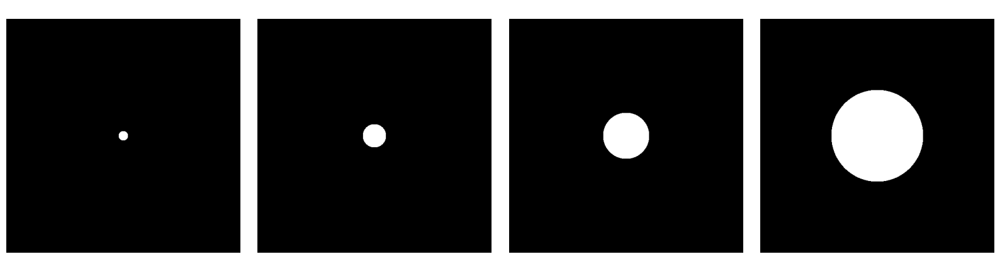

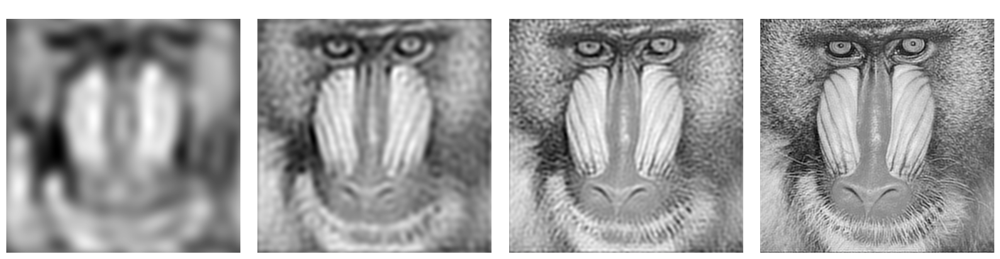

In [23]:
sizes = [20,50,100,200]
masks = [fft_filter(img.shape, 'low_pass', [s,s], mask_type = 'boxcar') for s in sizes]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             '    ',
             title='',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

## Passa-alta

Conforme explicado anteriormente, detalhes da imagem se encontram nas altas frequências e o preenchimento nas baixas. Ao deixar passar apenas as frequências mais altas, vamos descartar o preenchimento da imagem e ficar com as bordas.

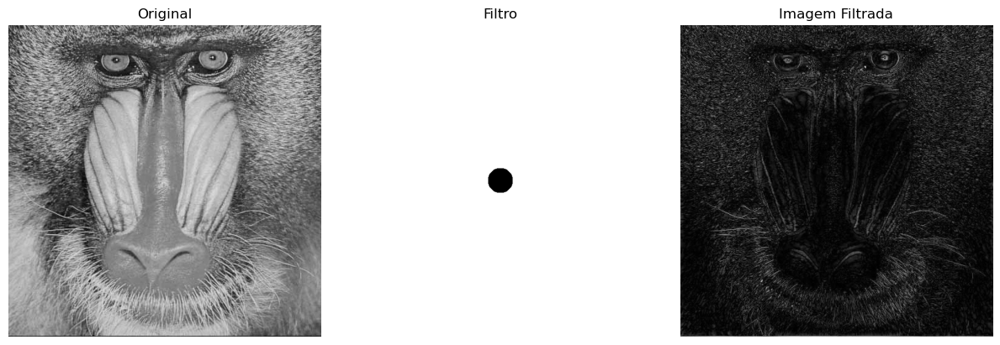

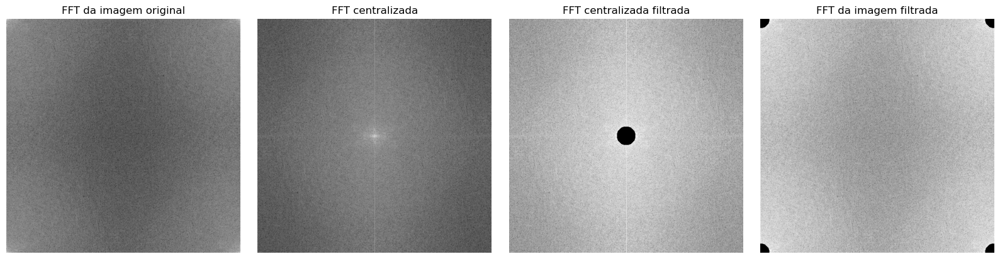

In [24]:
img  = images[baboon]
center_size = [40,40]
mask = fft_filter(img.shape, 'high_pass', center_size, mask_type = 'boxcar')

fft_steps, labels = fft_apply_filter(img,mask,return_steps=True)


compare_imgs(fft_steps[0:3],
             labels[0:3],
             title='',
             black_pixels_ratio=False);
compare_imgs(fft_steps[3:],
             labels[3:],
             title='',
             black_pixels_ratio=False);

### Testando diferentes tamanhos

Quanto maior o tamanho do filtro, mais intenso é o efeito de apagar o preenchimento e deixar passar apenas as transições mais bruscas da imagem.

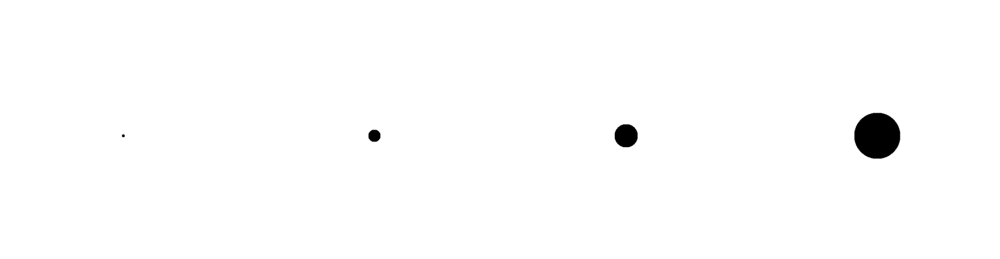

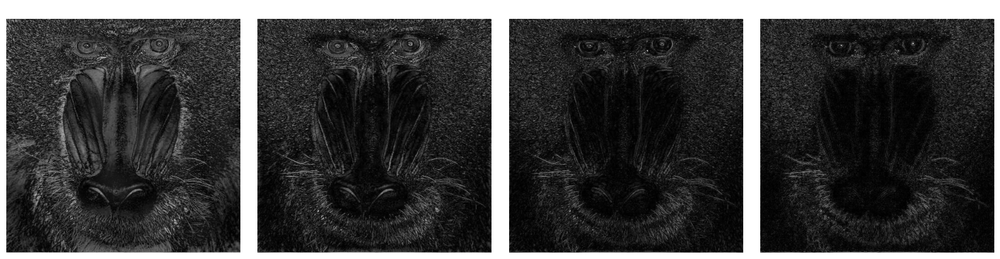

In [25]:
sizes = [5,25,50,100]
masks = [fft_filter(img.shape, 'high_pass',[s,s], mask_type = 'boxcar') for s in sizes]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             '    ',
             title='',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

## Visualização em 3d da imagem

Antes de continuar com os filtros passa-faixa e rejeita-faixa, vamos utilizar uma abordagem visual diferente para ilustrar o funcionamento dos filtros nas imagens.

Esse conceito pode ficar um pouco mais intuitivo plotando uma superfície 3D, representando a intensidade de cada pixel como a altura de cada ponto dessa superfície. Podemos associar as zonas mais íngremes às altas frequências e as zonas mais planas às baixas frequências (independente da altura)

In [26]:
def plot_image_in_3d(img, angle, ax=None):
    '''
    Recebe uma imagem monocromática e plota sua superfície em 3D, atribuíndo a altura de cada ponto como sendo a intensidade de cada pixel.
    Features:
        img   -> imagem a ser plotada
        res   -> quantidade de pixels no grupo a ser plotado (para res=5, por exemplo, cada ponto plotado sera a média dos 5 pixels na região)
        angle -> ângulo que o gráfico será plotado
    '''
    if ax==None:
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
    X,Y = np.meshgrid(np.arange(1,np.shape(img)[1]+1),np.arange(1,np.shape(img)[0]+1))
    ax.plot_surface(X[0::1,0::1],Y[0::1,0::1],img[0::1,0::1],cmap='inferno', edgecolor='none')
    #ax.set_title()
    ax.mouse_init()
    ax.view_init(*angle)

def show_3d_rotations(img, upside_down=False,figtitle=''):
    '''
    Essa função faz 3 plots em 3D da superfície de uma imagem, rotacionando em 3 ângulos diferentes para facilitar o entendimento do plot
    Features:
        img         -> imagem a ser plotada
        upside_down -> ângulo que o gráfico será plotado
        figtitle    -> título da figura a ser mostrado no gráfico
    '''
    fig = plt.figure(figsize=(12,5))
    ax = [fig.add_subplot(1, 3, n, projection='3d') for n in range(1,4)]

    teta=180*upside_down
    plot_image_in_3d(img, angle=(90+teta,90+teta),ax=ax[0])
    plot_image_in_3d(img, angle=(80+teta,70+teta),ax=ax[1])
    plot_image_in_3d(img, angle=(40+teta,80+teta),ax=ax[2])
    
    fig.suptitle(figtitle)
    fig.subplots_adjust(top=1.1)

Nesse tópico, em específico, vamos utilizar a imagem wedge pois produz uma superfície mais simples, e mais fácil de interpretar vizualmente.

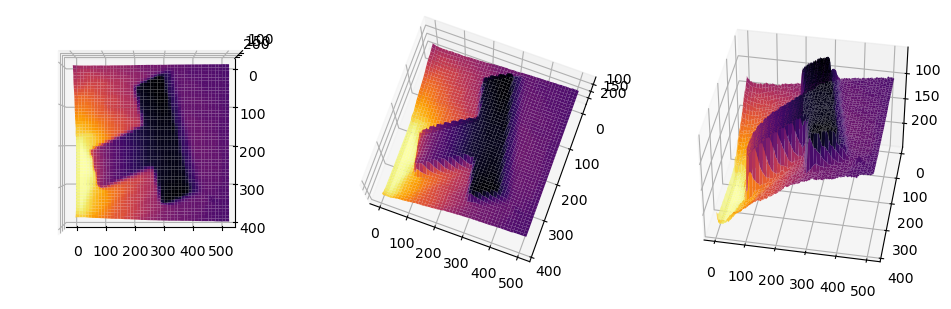

In [27]:
img = images[wedge]

show_3d_rotations(img, upside_down=True)

### Filtro passa baixa em 3D

Podemos observar que o filtro passa baixa atenua as partes mais íngremes da imagem (altas frequências), daí o efeito de borramento.

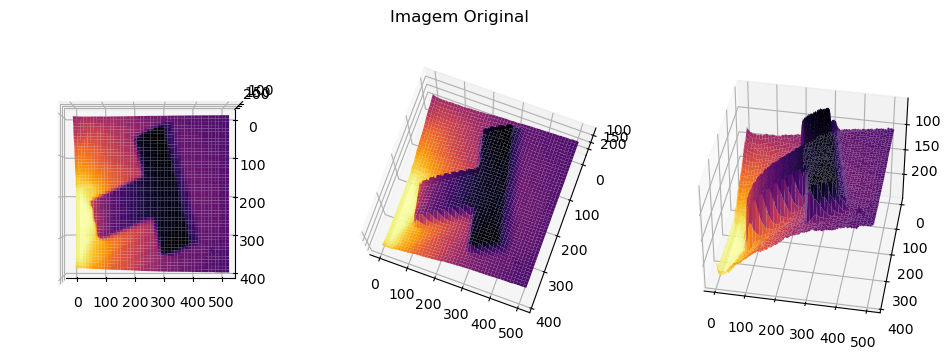

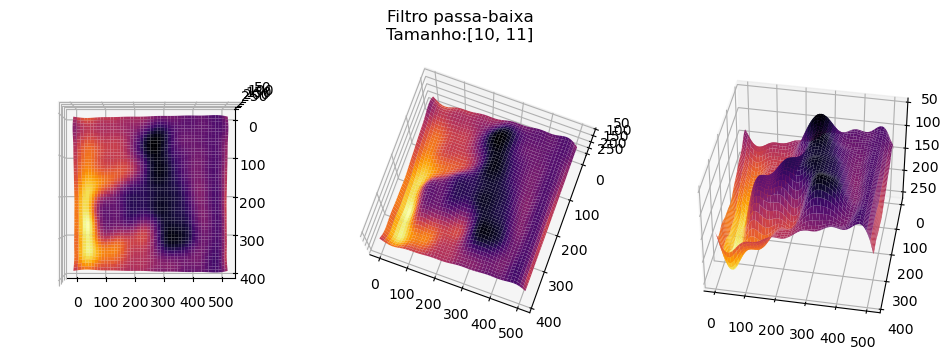

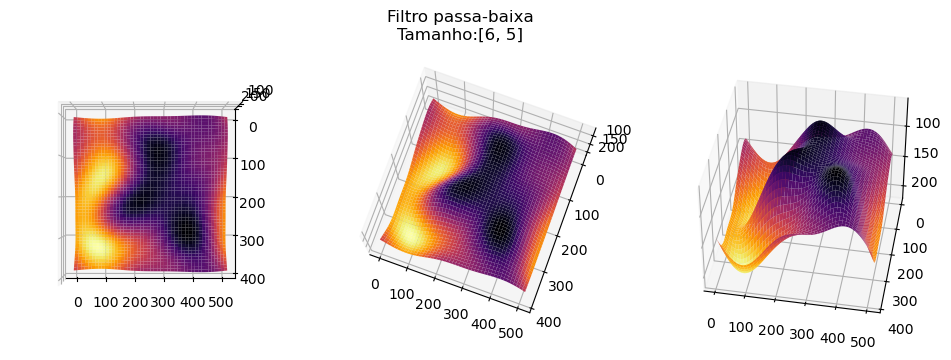

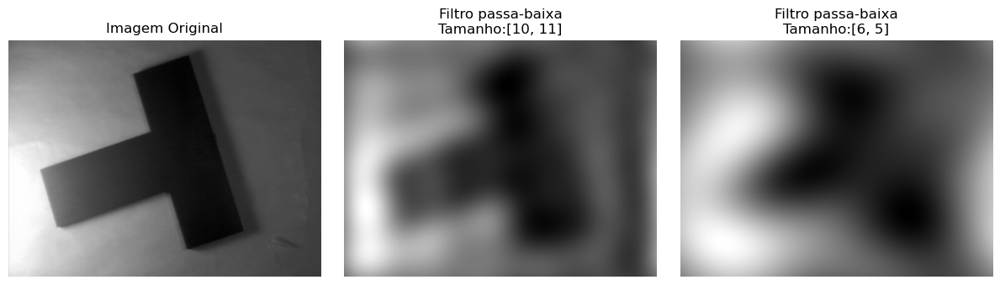

In [28]:
img = images[wedge]

#filtro passa baixa 1
center_size_1 = [10,10]
low_pass_1 = fft_filter(img.shape,'low_pass', center_size_1, mask_type = 'boxcar')

#filtro passa baixa 2
center_size_2 = [5,5]
low_pass_2 = fft_filter(img.shape,'low_pass', center_size_2, mask_type = 'boxcar')

#imagens geradas após a aplicação dos filtros
fft_img_1 = fft_apply_filter(img,low_pass_1)
fft_img_2 = fft_apply_filter(img,low_pass_2)

#títulos dos gráficos
labels = ['Imagem Original',f'Filtro passa-baixa\nTamanho:{center_size_1}',f'Filtro passa-baixa\nTamanho:{center_size_2}']

#imagens a serem plotadas
imgs_to_compare = [img,fft_img_1,fft_img_2]

#funções que plotam as imagens em 3D
show_3d_rotations(img, upside_down=True, figtitle=labels[0])
show_3d_rotations(fft_img_1, upside_down=True, figtitle=labels[1])
show_3d_rotations(fft_img_2, upside_down=True, figtitle=labels[2])

#imagens em 2D
compare_imgs(imgs_to_compare,labels,black_pixels_ratio=False);

### Filtro passa alta em 3D

Já o filtro passa alta, deixa passar apenas as oscilações mais ingremes da figura.

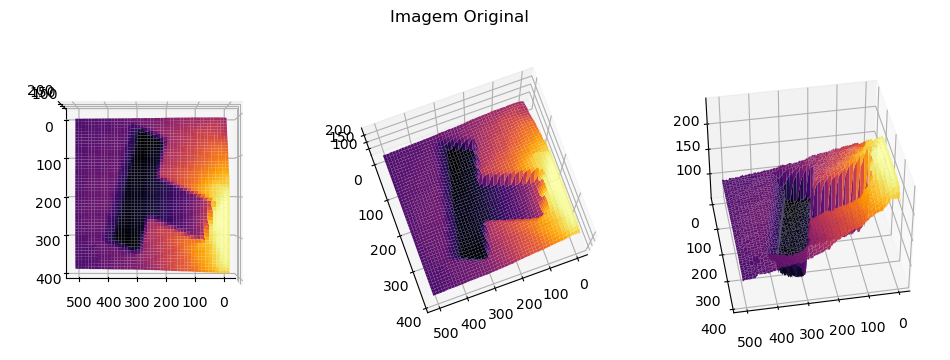

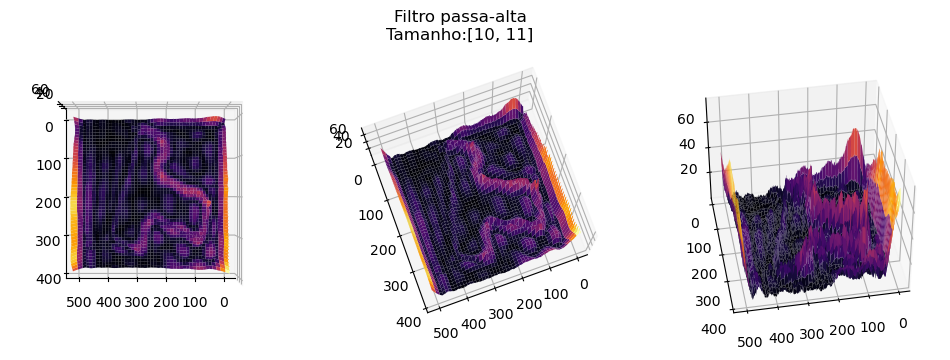

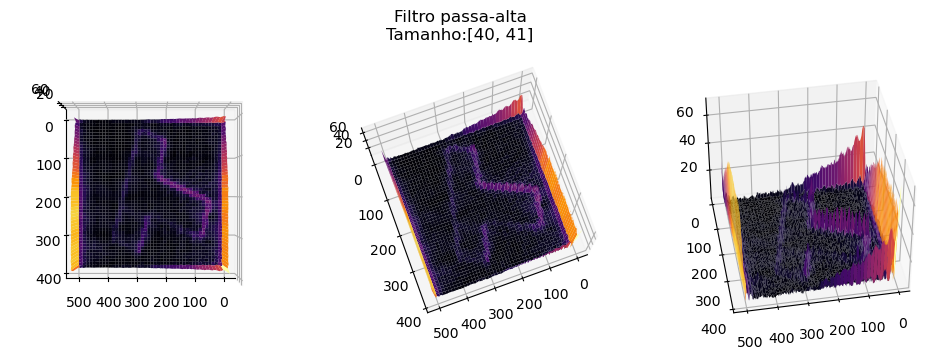

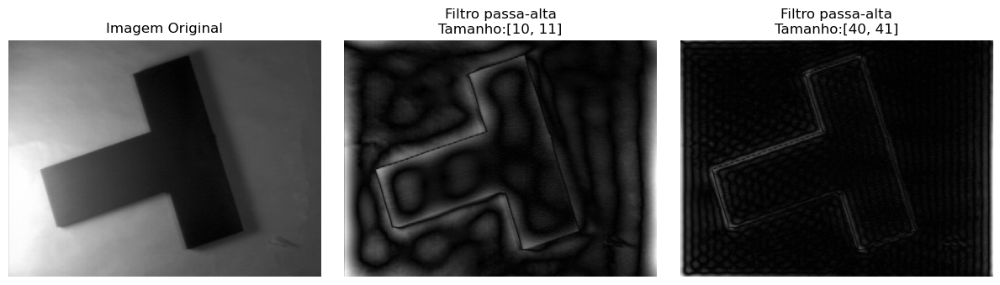

In [29]:
img = images[wedge]

#filtro passa alta 1
center_size_1 = [10,10]
high_pass_1 = fft_filter(img.shape,'high_pass', center_size_1, mask_type = 'boxcar')

#filtro passa alta 2
center_size_2 = [40,40]
high_pass_2 = fft_filter(img.shape,'high_pass', center_size_2, mask_type = 'boxcar')

#imagens geradas após a aplicação dos filtros
fft_img_1 = fft_apply_filter(img,high_pass_1)
fft_img_2 = fft_apply_filter(img,high_pass_2)

#títulos dos gráficos
labels = ['Imagem Original',f'Filtro passa-alta\nTamanho:{center_size_1}',f'Filtro passa-alta\nTamanho:{center_size_2}']

#imagens a serem plotadas
imgs_to_compare = [img,fft_img_1,fft_img_2]

#funções que plotam as imagens em 3D
show_3d_rotations(img, upside_down=False, figtitle=labels[0])
show_3d_rotations(fft_img_1, upside_down=False, figtitle=labels[1])
show_3d_rotations(fft_img_2, upside_down=False, figtitle=labels[2])

#imagens em 2D
compare_imgs(imgs_to_compare,labels,black_pixels_ratio=False);

#### Utilizando a figura baboon

Abaixo vamos utilizar a figura baboon, que é mais complexa. Ao aplicar o filtro passa alta, podemos observar com facilidade a atenuação das baixas frequências presentes no focinho e no pelo do babuíno.

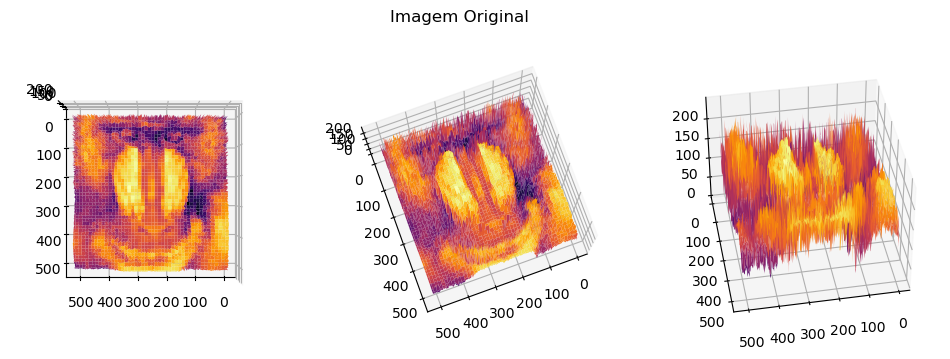

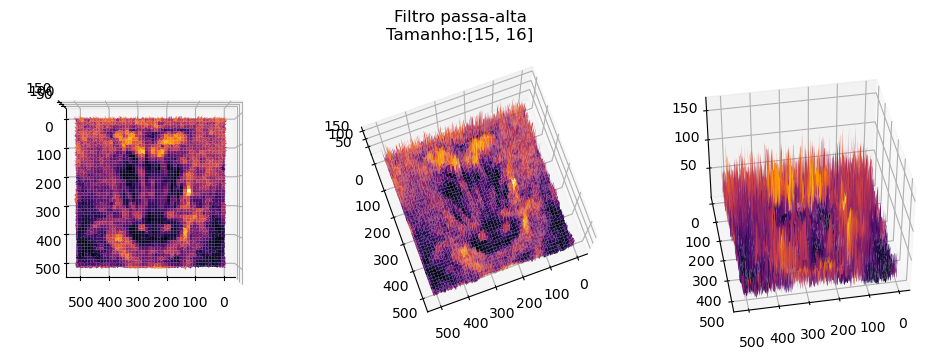

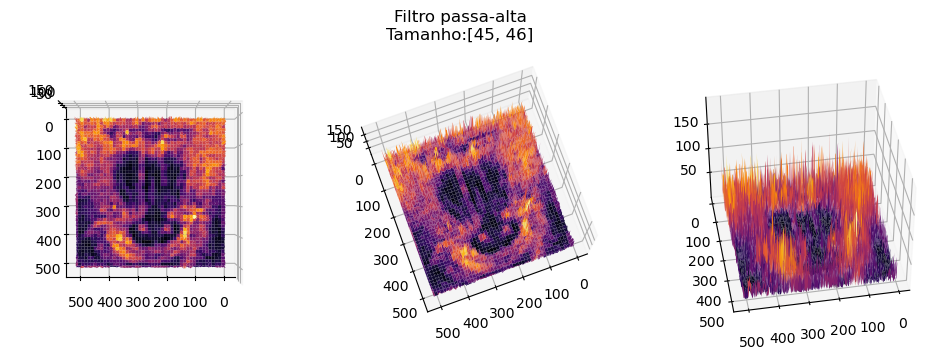

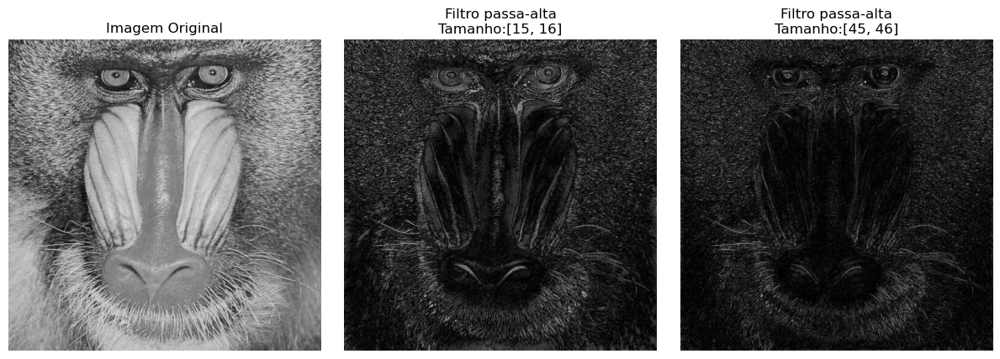

In [30]:
#retirei a última linha da imagem pois tinha um ruído que atrapalha a visualização em 3D
img = images[baboon][:-1]

#filtro passa baixa 1
center_size_1 = [15,15]
high_pass_1 = fft_filter(img.shape,'high_pass', center_size_1, mask_type = 'boxcar')

#filtro passa baixa 2
center_size_2 = [45,45]
high_pass_2 = fft_filter(img.shape,'high_pass', center_size_2, mask_type = 'boxcar')

#imagens geradas após a aplicação dos filtros
fft_img_1 = fft_apply_filter(img,high_pass_1)
fft_img_2 = fft_apply_filter(img,high_pass_2)

#títulos dos gráficos
labels = ['Imagem Original',f'Filtro passa-alta\nTamanho:{center_size_1}',f'Filtro passa-alta\nTamanho:{center_size_2}']

#imagens a serem plotadas
imgs_to_compare = [img,fft_img_1,fft_img_2]

#funções que plotam as imagens em 3D
show_3d_rotations(img, upside_down=False, figtitle=labels[0])
show_3d_rotations(fft_img_1, upside_down=False, figtitle=labels[1])
show_3d_rotations(fft_img_2, upside_down=False, figtitle=labels[2])

#imagens em 2D
compare_imgs(imgs_to_compare,labels,black_pixels_ratio=False);

Após esse pequeno desvio, vamos prosseguir com os filtros passa faixa e rejeita-faixa.

## Passa-faixa

O filtro passa faixa seleciona uma determinada faixa de frequências, barrando as frequências mais altas e as mais baixas, deixando passar apenas uma zona intermediária. É como se fosse a combinação de um filtro passa baixa com um filtro passa alta de diâmetro maior.

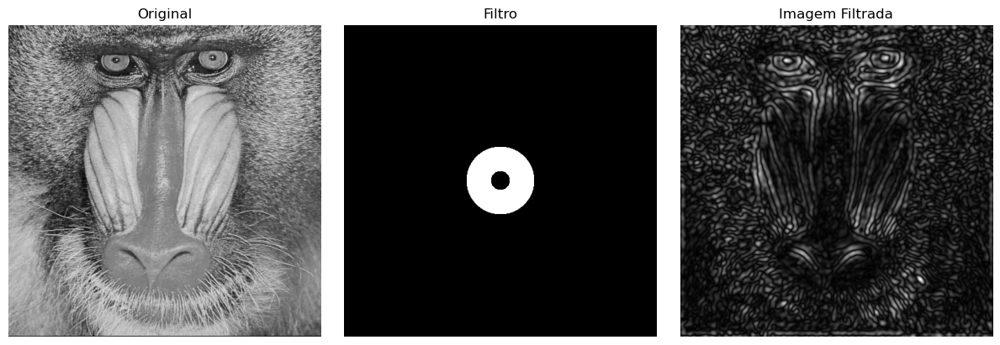

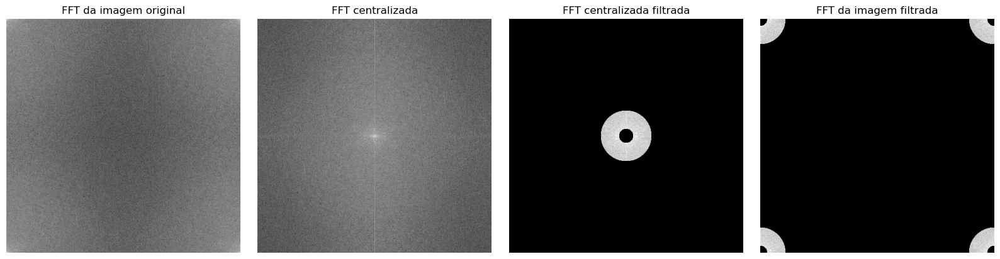

In [31]:
img  = images[baboon]
center_size_upper = [110,110]
center_size_lower = [30,30]
mask = fft_filter(img.shape, 'band_pass', center_size_upper, center_size_lower, mask_type = 'boxcar')

fft_steps, labels = fft_apply_filter(img,mask,return_steps=True)


compare_imgs(fft_steps[0:3],
             labels[0:3],
             title='',
             black_pixels_ratio=False);
compare_imgs(fft_steps[3:],
             labels[3:],
             title='',
             black_pixels_ratio=False);

### Testando diferentes tamanhos

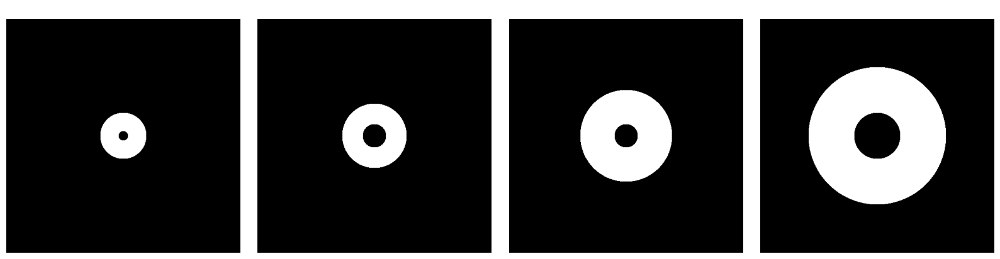

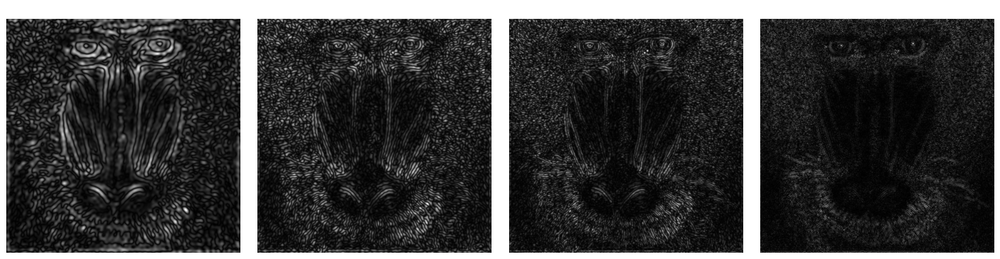

In [32]:
sizes = [100,140,200,300]
lower_sizes = [20,50,50,100]

masks = [fft_filter(img.shape, 'band_pass', [s,s],[l,l], mask_type = 'boxcar') for s,l in zip(sizes,lower_sizes)]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             '    ',
             title='',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

## Rejeita-faixa

É o complementar do filtro passa faixa. Com ele é possível borrar a imagem, preservando alguma parte dos detalhes da imagem. Pode ser usado para deixar uma textura mais uniforme, conservando os contornos da imagem, por exemplo.

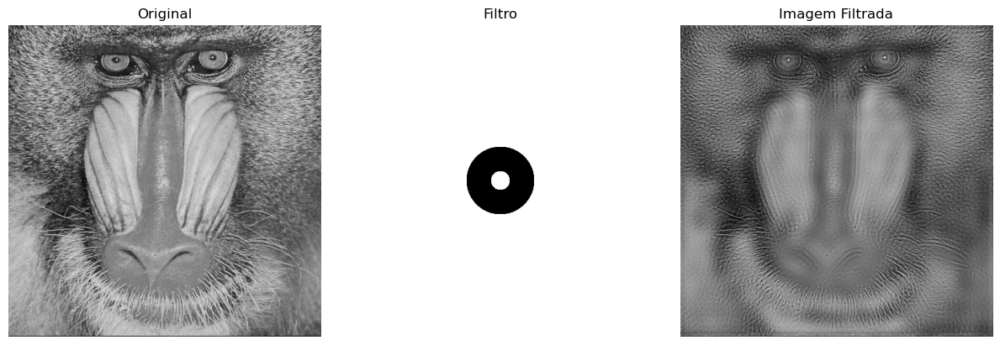

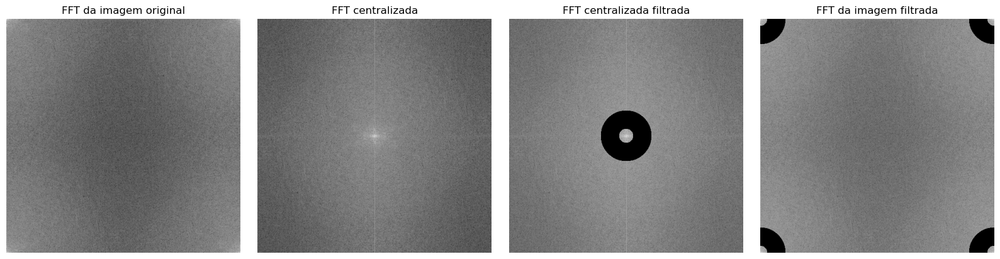

In [33]:
img  = images[baboon]
center_size_upper = [110,110]
center_size_lower = [30,30]
mask = fft_filter(img.shape, 'band_stop', center_size_upper, center_size_lower, mask_type = 'boxcar')

fft_steps, labels = fft_apply_filter(img,mask,return_steps=True)


compare_imgs(fft_steps[0:3],
             labels[0:3],
             title='',
             black_pixels_ratio=False);
compare_imgs(fft_steps[3:],
             labels[3:],
             title='',
             black_pixels_ratio=False);

### Testando diferentes tamanhos

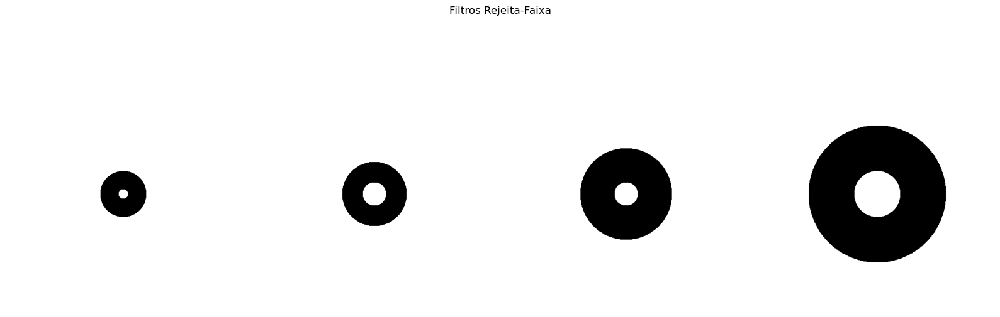

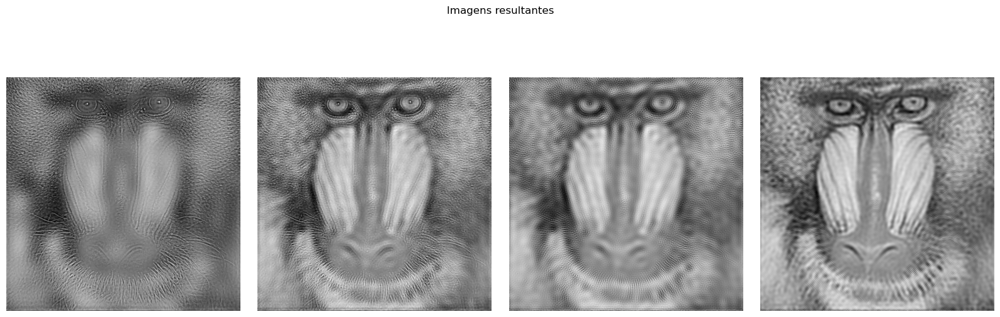

In [34]:
sizes = [100,140,200,300]
lower_sizes = [20,50,50,100]

masks = [fft_filter(img.shape, 'band_stop', [s,s],[l,l], mask_type = 'boxcar') for s,l in zip(sizes,lower_sizes)]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             '    ',
             title='Filtros Rejeita-Faixa',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='Imagens resultantes',
             black_pixels_ratio=False);

## Utilizando outros tipos de máscaras

É possível utilizar outras window functions para gerar o filtro, tendo assim uma transição mais suave entre as frequências que passam ou não.
Abaixo, vamos mostrar brevemente alguns exemplos.

Mesmo utilizando o mesmo raio, podemos observar resultados bem diferentes utilizando diferentes window functions. Não vamos nos aprofundar nessa análise pois não está no escopo de trabalho, mas acredito ser importante citar e ilustrar essa possibilidade.

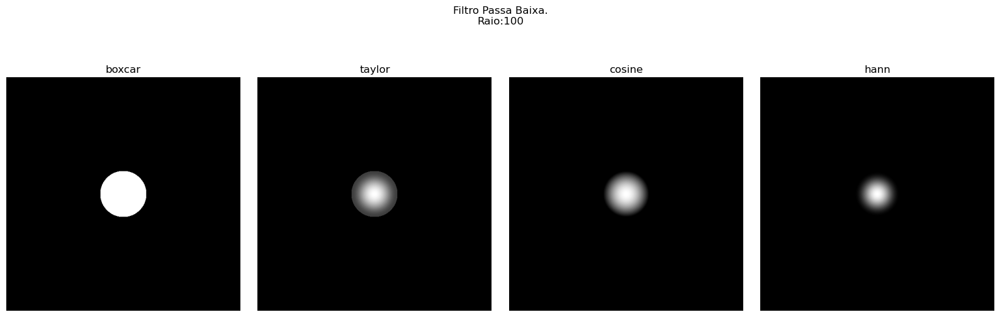

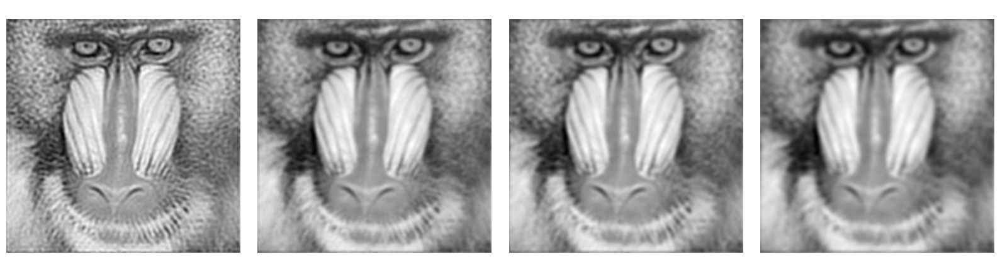

In [35]:
size = 100
window_func = ['boxcar','taylor', 'cosine', 'hann']

masks = [fft_filter(img.shape, 'low_pass', [size,size], mask_type = mask) for mask in window_func]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             window_func,
             title=f'Filtro Passa Baixa.\nRaio:{size}',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

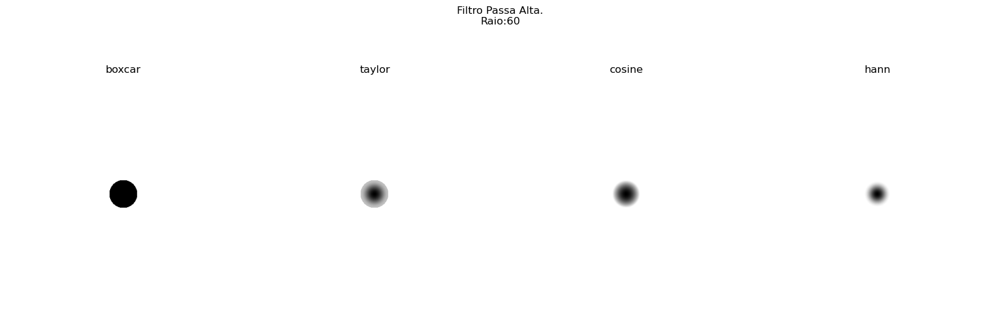

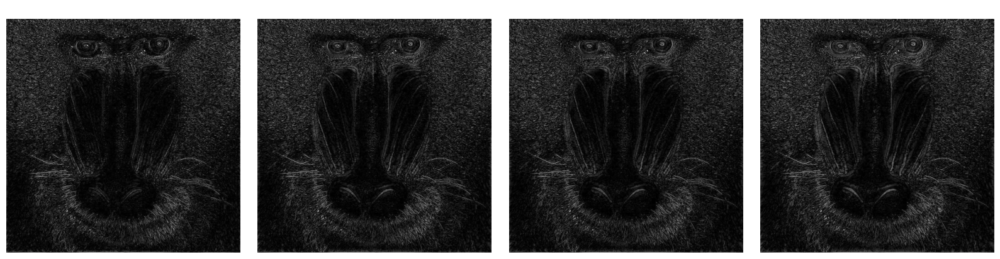

In [36]:
size = 60
window_func = ['boxcar','taylor', 'cosine', 'hann']

masks = [fft_filter(img.shape, 'high_pass', [size,size], mask_type = mask) for mask in window_func]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             window_func,
             title=f'Filtro Passa Alta.\nRaio:{size}',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

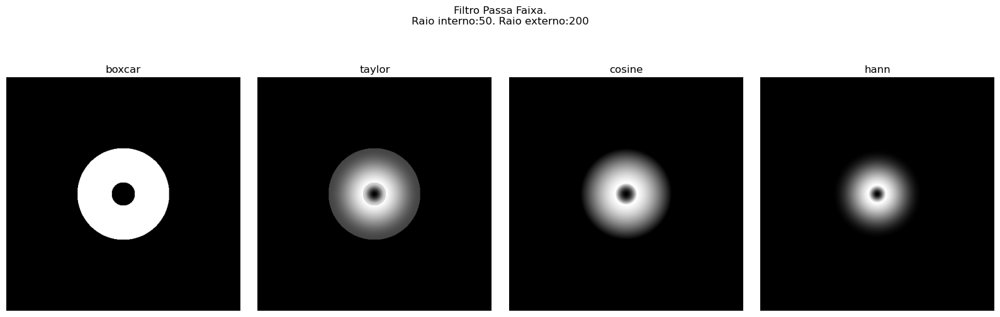

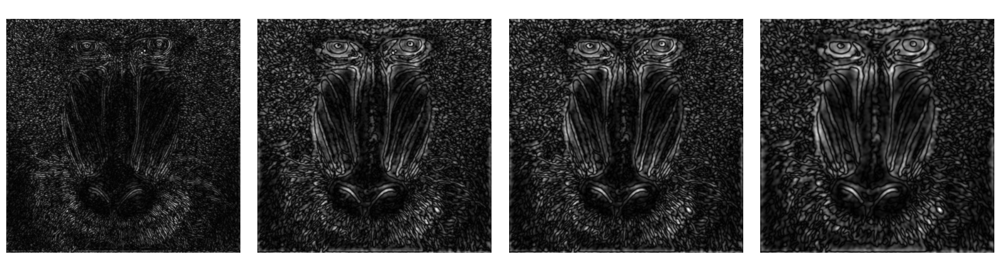

In [37]:
size = 200
lower_size = 50
window_func = ['boxcar','taylor', 'cosine', 'hann']

masks = [fft_filter(img.shape, 'band_pass', [size,size],[lower_size,lower_size], mask_type = mask) for mask in window_func]
imgs  = [fft_apply_filter(img,mask) for mask in masks]

compare_imgs(masks,
             window_func,
             title=f'Filtro Passa Faixa.\nRaio interno:{lower_size}. Raio externo:{size}',
             black_pixels_ratio=False);
compare_imgs(imgs,
             '    ',
             title='',
             black_pixels_ratio=False);

## Compressão

A compressão consiste em identificar as frequências que contêm mais informação em uma imagem e filtrar as demais.

Antes de falar sobre a compressão, vamos introduzir o conceito de potência.

Dada a transformada de uma imagem:  
$|F(u,v)| =\left[R^2(u,v) + I^2(u,v)\right]^{1/2}$

O espectro da energia é definido como:  
$E(u,v) =|F(u,v)|^2 = R^2(u,v) + I^2(u,v)$

In [38]:
def plot_energy_circles(img,ax):
    '''
    Recebe uma imagem e plota a energia contida em alguns circulos no domínio da frequência
    img       -> imagem
    ax        -> espaço  onde será plotado a magnitude da FFT e seus círculos de energia
    '''
    #calcula a transformada de fourier
    original_fft = fft2(img)
    #centraliza a transformada
    center_fft = fftshift(original_fft)
    
    #definimos a energia total da imagem no domínio da frequência como
    #a soma do quadrado das magnitudes de cada frequência
    total_energy = np.sum(np.square(np.abs(center_fft)))
    
    s     = img.shape[0]
    sizes = np.array([s*0.02,s*0.05,s*.1,s*0.2]).astype(int)
    masks = [fft_filter(img.shape, 'low_pass', [s,s], mask_type = 'boxcar') for s in sizes]

    #calcula a energia em um determinado círculo
    circles_energy = np.array([np.sum(np.square(np.abs(center_fft*mask)))/total_energy for mask in masks])
    
    img_center = (np.array(img.shape)/2).astype('int')

    ax.imshow(np.log(1+np.abs(center_fft)))
    for size,color,energy in zip(sizes,color_palette("plasma"),circles_energy):
        circle = plt.Circle(np.flip(img_center),
                            radius=size,
                            **{'fill':False,'color':color},label=f'raio : {size}\nE(%): {round(100*energy,1)}')
        ax.add_patch(circle)
    ax.legend(framealpha=0.4,fontsize=8,labelcolor='white')

Abaixo podemos ver cada imagem, a magnitude das suas respectivas transformadas de Fourier e o percentual da energia contida em cada círculo.

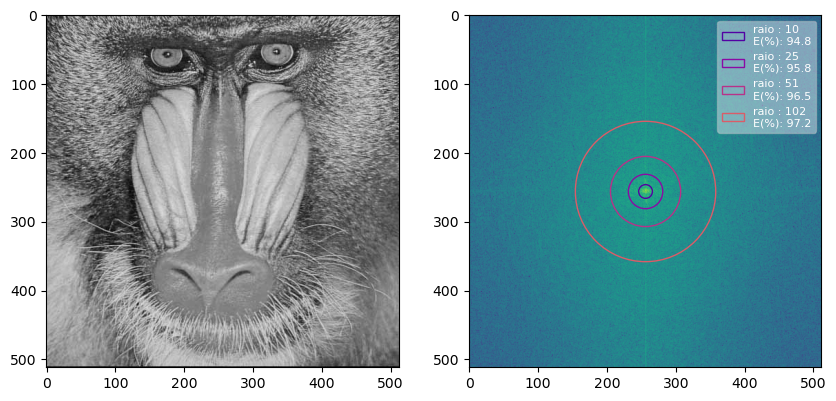

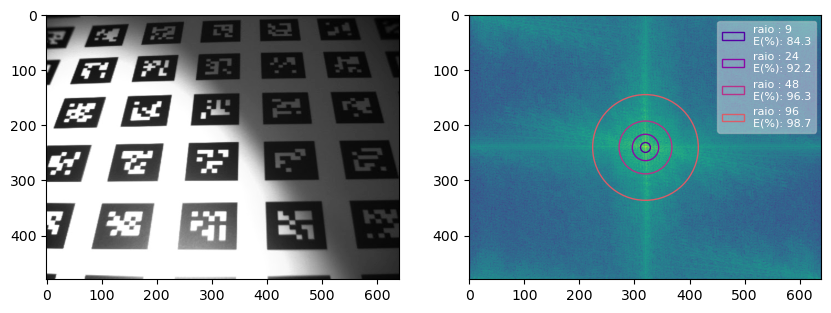

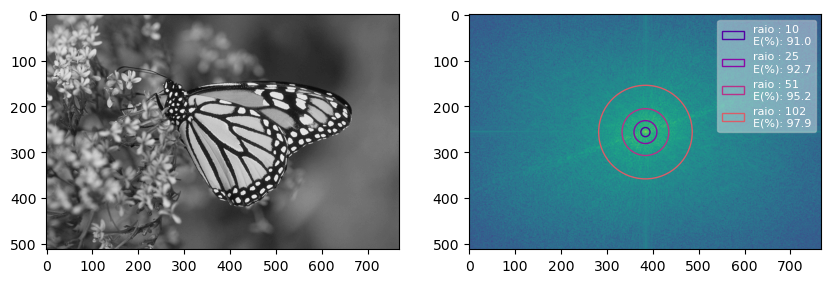

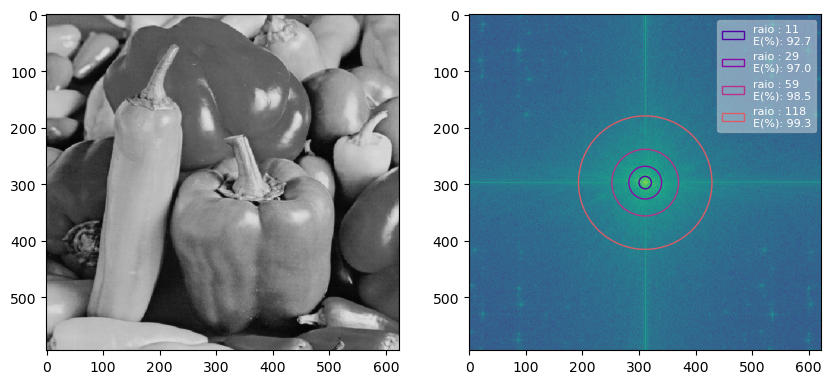

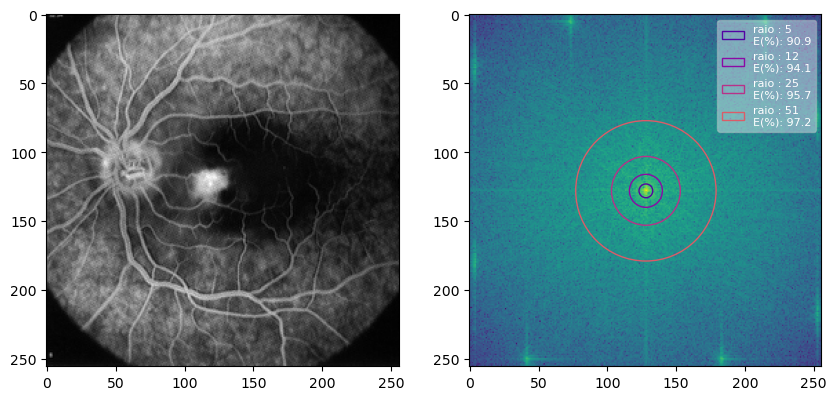

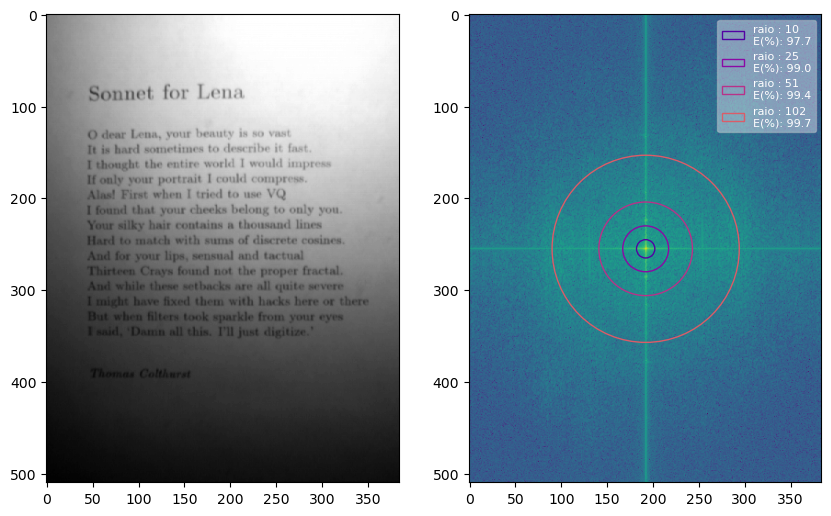

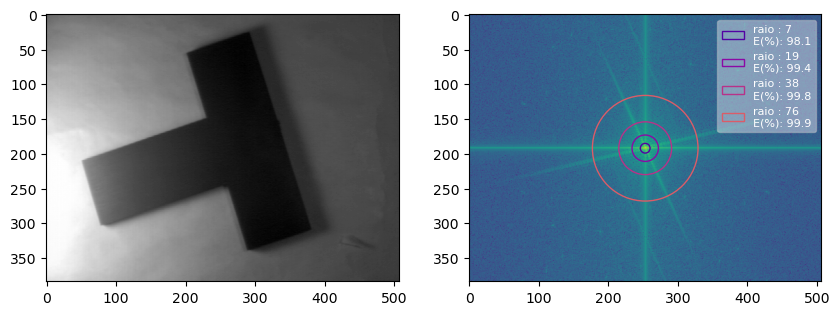

In [39]:
for img in images:
    fig, ax = plt.subplots(1,2,figsize=(10,10))
    ax[0].imshow(img,cmap='gray')
    plot_energy_circles(img,ax[1])

Nos gráficos acima é possível perceber que a maior parte da energia de uma imagem se encontra nas baixas frequências.

### Resultados da compressão

Código baseado nos vídeos:  
https://www.youtube.com/watch?v=uB3v6n8t2dQ  
https://www.youtube.com/watch?v=L9T3jNbCYf8

E nesse notebook (que é inspirado no vídeo também):  
https://github.com/DavidClawson/Brunton/blob/master/Brunton_Image_Compression_FFT.ipynb

In [40]:
def fft_compression(img, q, return_steps = False):
    '''
    Comprime uma imagem utilizando FFT
    Features:
        img          -> imagem a ser comprimida
        q            -> percentual das frequências que passarão para a imagem comprimida
                        o range deve estar no intervalo (0, 1)
        return_steps -> False: retorna apenas a imagem comprimida
                        True : retorna todos os passos do processo (prontos para plotar)
    '''
    if q <=0 or q>=1:
        raise ValueError(f"fft_compression: q={q} é inválido.\nq deve pertencer ao intervalo: (0, 1)")

    #transformada de fourier da imagem
    fft_img = fft2(img)

    #aqui ordenamos pelas frequências que tem a maior magnitude
    frequency_sorted = np.sort(np.abs(fft_img.reshape(-1)))

    #definimos um threshold como sendo o valor que preserva um percentual específico das frequências
    thresh_index = int(np.floor((1-q)*len(frequency_sorted)))
    thresh = frequency_sorted[thresh_index]

    #descobrimos os índices das frequências cuja magnitude ultrapassa o threshold
    passed_frequencies = np.abs(fft_img)>thresh
    
    #aplicamos a máscara com essa multiplicação simples
    fft_compressed_img = fft_img * passed_frequencies
    
    #Fazemos a inversa para sair do domínio da frequência e ter a imagem comprimida
    compressed_img = np.abs(ifft2(fft_compressed_img))
    
    if return_steps:
        fft_compression_steps = [np.log(1+np.abs(fftshift(fft_img))),fftshift(passed_frequencies),compressed_img,img]
        labels = ['FFT centralizada','Máscara','Imagem comprimida','Original']
        return fft_compression_steps, labels
        
    else:
        return compressed_img

Abaixo, podemos observar o resultado da compressão para diferentes valores de $q$ em algumas imagens.

Ao observar as frequências que continuam na imagem após a compressão, fica evidente que a maior parte da energia de uma imagem normal se concentra nas baixas freqüências

In [41]:
def get_img_size(img,extension='png'):
    '''
    retorna o tamanho (em KB, da imagem no formato escolhido)
    Features:
        img       -> imagem a ter o tamanho mensurado
        extension -> é necessário informar a extensão do arquivo póis o tamanho da imagem em disco depende
                     da extensão. Alguns valores possíveis: 'png','jpg','pgm','bmp'.
                     O formato padrão é o png e, para o formato jpg foi adotada a qualidade sem perdas.
    Return:
        im_size   -> tamanho, em KB, da imagem
    '''
    tmp_filename = 'img_temp.'+extension
    #caso utilize o formato jpg, define que será salvo sem perdas
    if extension == 'jpg':
        kwarg = {'quality':100}
    else:
        kwarg = {}
    skimage.io.imsave(tmp_filename,np.round(img).astype('uint8'),**kwarg)
    im_size = round(os.stat(tmp_filename).st_size/1000)
    os.remove(tmp_filename)
    return im_size

In [42]:
def get_img_energy(img):
    '''
    Recebe uma imagem e retorna a sua energia no domínio da frequência
    img       -> imagem
    '''
    #calcula a transformada de fourier
    original_fft = fft2(img)
    
    #definimos a energia total da imagem no domínio da frequência como
    #a soma do quadrado das magnitudes de cada frequência
    energy = np.sum(np.square(np.abs(original_fft)))
    
    return energy

### Imagem: baboon

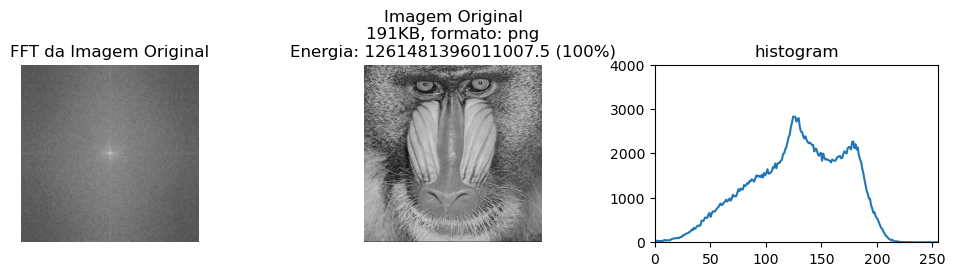

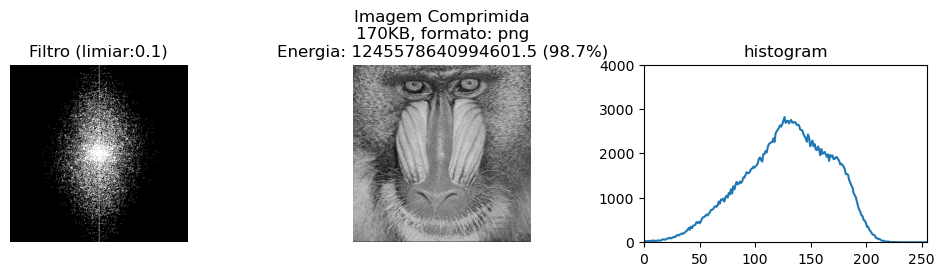

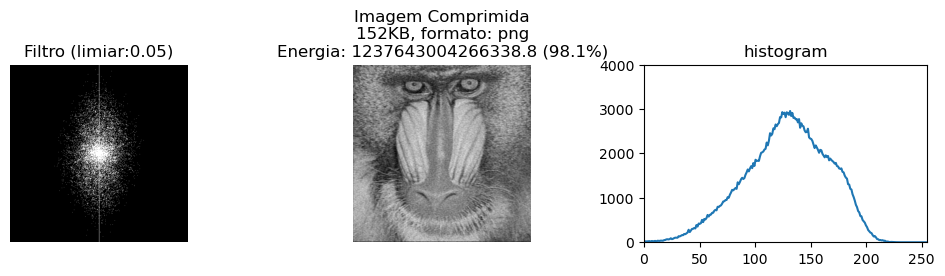

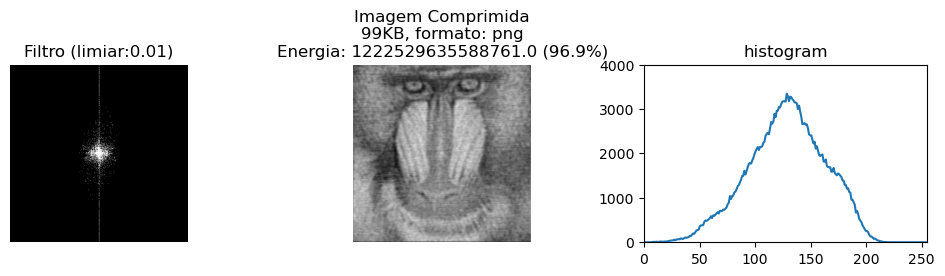

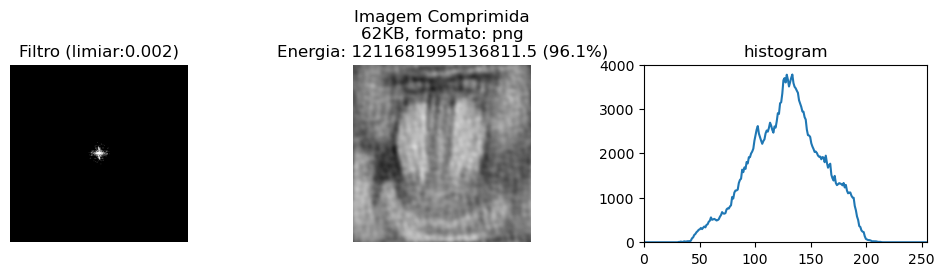

In [46]:
img = images[baboon]

extension = 'png'
im_size = get_img_size(img,extension)
total_energy = get_img_energy(img)

label = ['FFT da Imagem Original',f'Imagem Original\n{im_size}KB, formato: {extension}\nEnergia: {total_energy} (100%)']
plot_fft_histogram(np.log(1+np.abs(fftshift(fft2(img)))),img,label,ylim=4000)

for q in (0.1, 0.05, 0.01, 0.002):
    fft_compression_steps, labels = fft_compression(img,q,return_steps=True)
    im_size = get_img_size(fft_compression_steps[2],extension)
    energy = get_img_energy(fft_compression_steps[2])
    label = [f'Filtro (limiar:{q})',f'Imagem Comprimida\n{im_size}KB, formato: {extension}\nEnergia: {energy} ({round(100*energy/total_energy,1)}%)']
    plot_fft_histogram(fft_compression_steps[1],fft_compression_steps[2],label,ylim=4000)

### Imagem: wedge

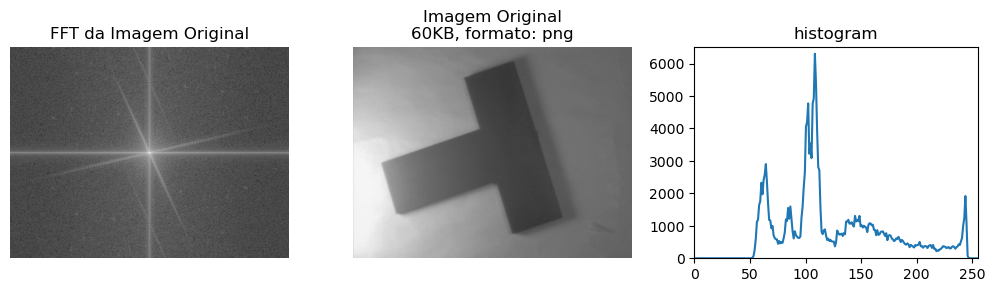

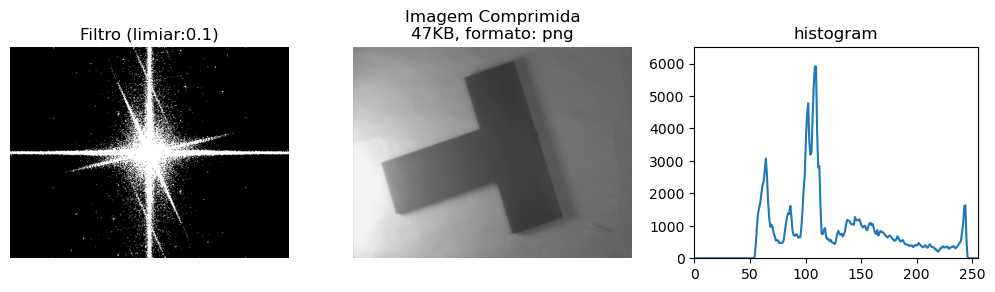

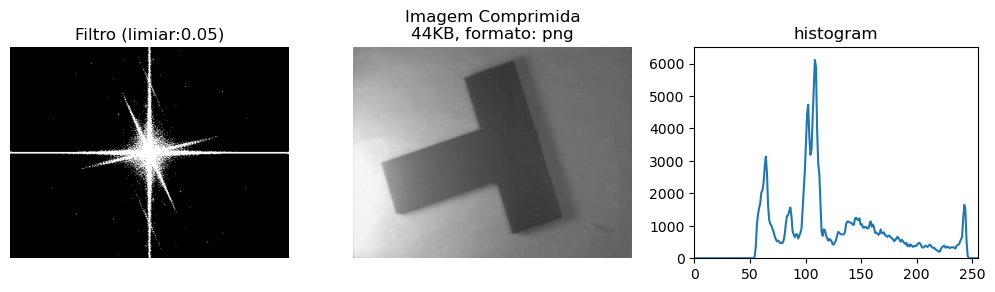

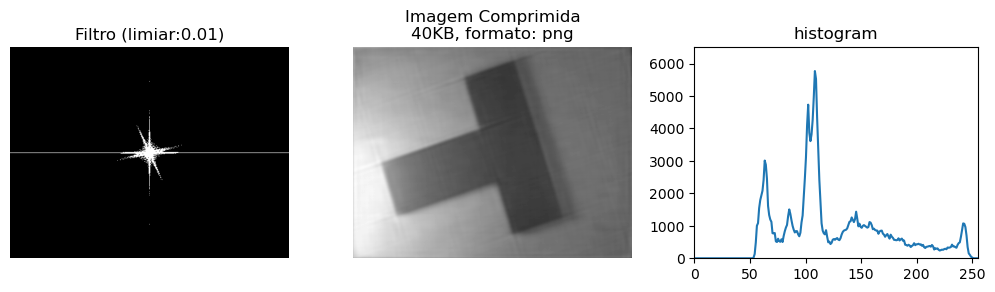

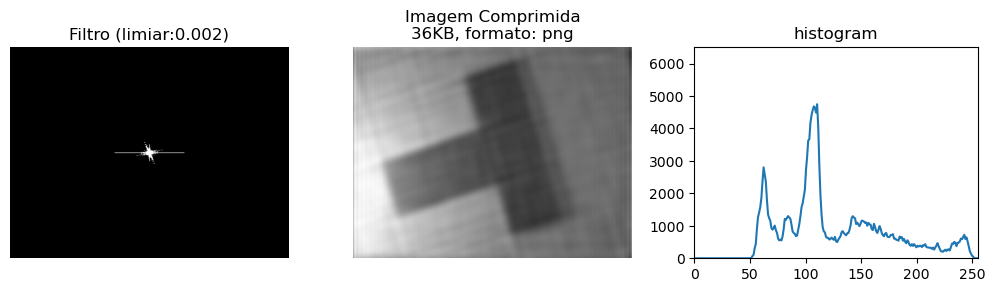

In [44]:
img = images[wedge]

extension = 'png'
im_size = get_img_size(img,extension)
label = ['FFT da Imagem Original',f'Imagem Original\n{im_size}KB, formato: {extension}']
plot_fft_histogram(np.log(1+np.abs(fftshift(fft2(img)))),img,label,ylim=6500)

for q in (0.1, 0.05, 0.01, 0.002):
    fft_compression_steps, labels = fft_compression(img,q,return_steps=True)
    im_size = get_img_size(fft_compression_steps[2],extension)
    label = [f'Filtro (limiar:{q})',f'Imagem Comprimida\n{im_size}KB, formato: {extension}']
    plot_fft_histogram(fft_compression_steps[1],fft_compression_steps[2],label,ylim=6500)

### Imagem: peppers

Essa imagem teve um resultado inesperado pois a imagem após compressão no domínio da frequência psssou a ocupar um tamanho maior em disco do que a imagem original.

Conforme discutido em sala de aula, uma das possíveis explicações desse fenômeno pode ser que o próprio formato png já aplica uma compressão sem perdas da imagem para que ela possa ser armazenada em disco e não é incomum que alguns tipos de dados ao sofrerem uma segunda compressão possam não sofrer alterações em seu tamanho (ou até ter seu tamanho em disco aumentado).

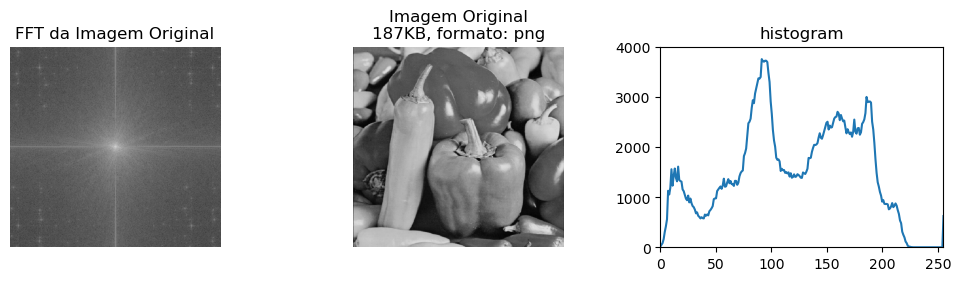

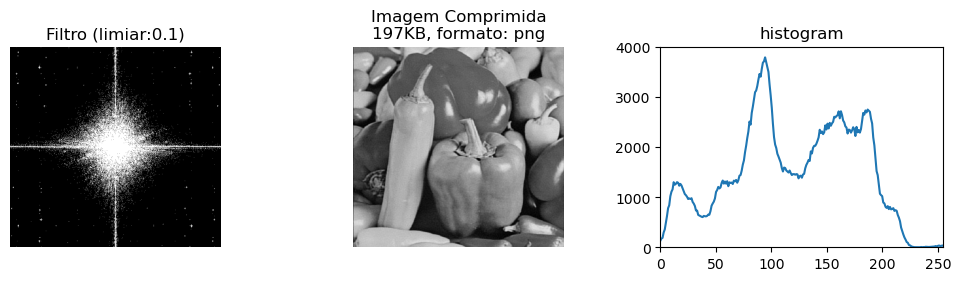

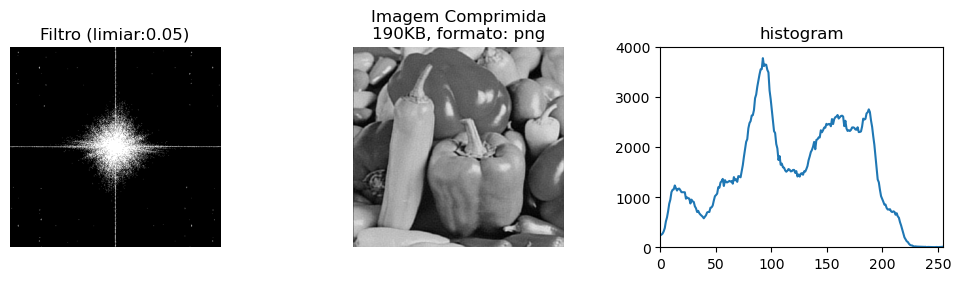

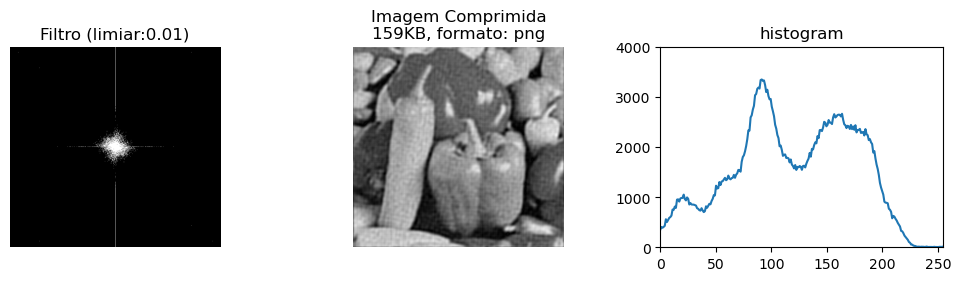

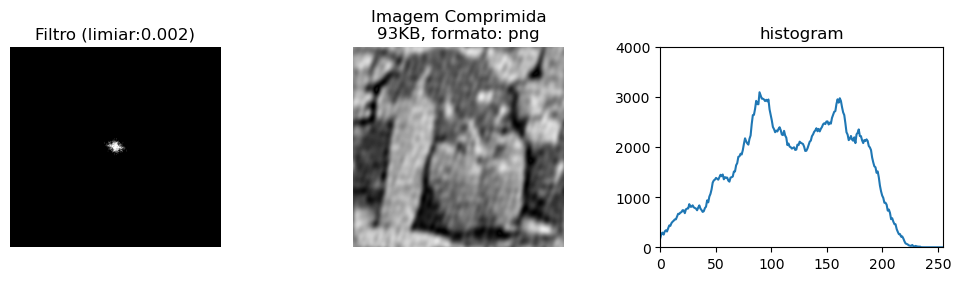

In [47]:
img = images[peppers]

extension = 'png'
im_size = get_img_size(img,extension)
label = ['FFT da Imagem Original',f'Imagem Original\n{im_size}KB, formato: {extension}']
plot_fft_histogram(np.log(1+np.abs(fftshift(fft2(img)))),img,label,ylim=4000)

for q in (0.1, 0.05, 0.01, 0.002):
    fft_compression_steps, labels = fft_compression(img,q,return_steps=True)
    im_size = get_img_size(fft_compression_steps[2],extension)
    label = [f'Filtro (limiar:{q})',f'Imagem Comprimida\n{im_size}KB, formato: {extension}']
    plot_fft_histogram(fft_compression_steps[1],fft_compression_steps[2],label,ylim=4000)

Ao utilizar o formato jpg sem perdas, observamos que a imagem comprimida tem um tamanho menor, como é o esperado, corroborando a hipótese que o comportamento acima se deve à compressão adotada pelo formato png.

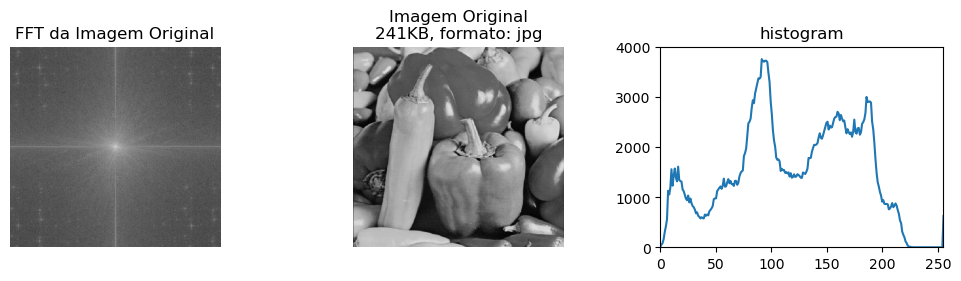

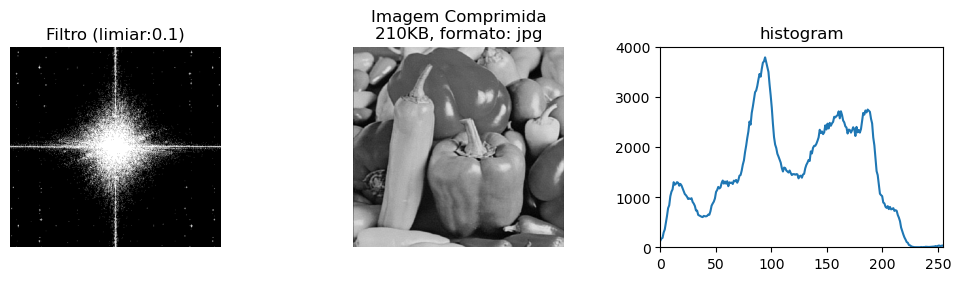

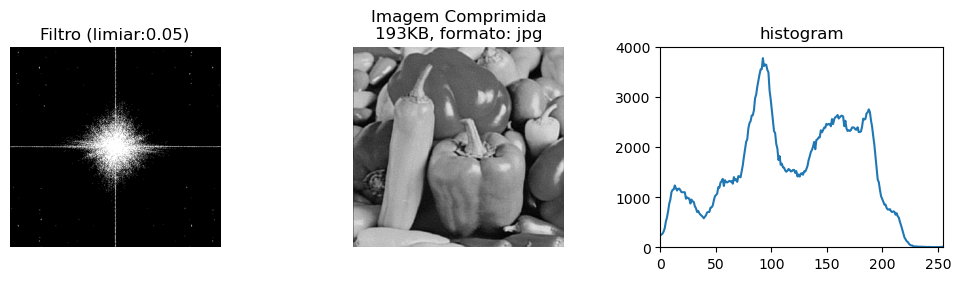

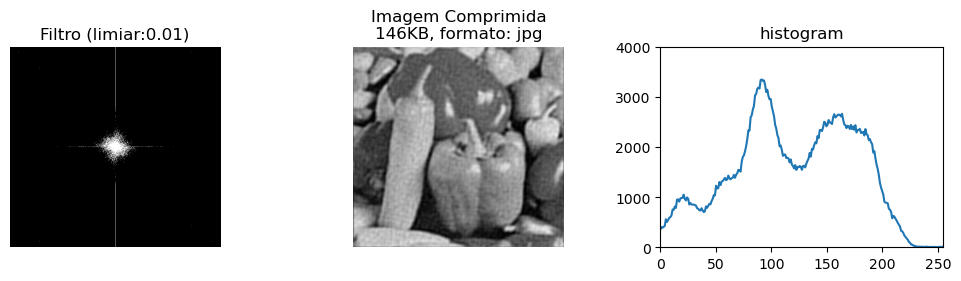

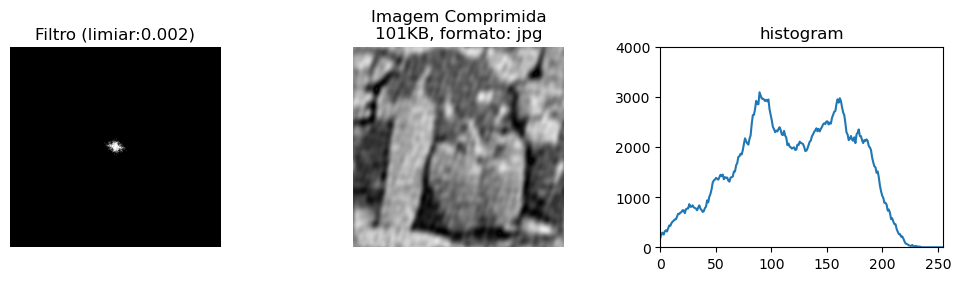

In [48]:
img = images[peppers]

extension = 'jpg'
im_size = get_img_size(img,extension)
label = ['FFT da Imagem Original',f'Imagem Original\n{im_size}KB, formato: {extension}']
plot_fft_histogram(np.log(1+np.abs(fftshift(fft2(img)))),img,label,ylim=4000)

for q in (0.1, 0.05, 0.01, 0.002):
    fft_compression_steps, labels = fft_compression(img,q,return_steps=True)
    im_size = get_img_size(fft_compression_steps[2],extension)
    label = [f'Filtro (limiar:{q})',f'Imagem Comprimida\n{im_size}KB, formato: {extension}']
    plot_fft_histogram(fft_compression_steps[1],fft_compression_steps[2],label,ylim=4000)